# CAR NUMBER PLATE DETECTION AND RECOGNITION 


# Description

# Table of contents

# 1 Introduction
### 2 Data collection 
#### 2.1 Imports
#### 2.2 Data method
### 3 Exploratory Data Analysis(EDA)
### 4 Visualization
### 5 Data Preprocessing
#### 5.1 Data Cleaning 
#### 3.2 Enhancing quality of images
#### 5.3 Apply the OCR model
#### 5.4 Feature Engineering
##### 5.4. Feature Scaling
### 6 Model Selection
#### 6.1 Training the model
#### 6.2 Evaluation

# 1- Introduction

# A- License Plates Dataset of world:

# 2- Data collection

## 2.1 Imports

In [4]:
import pandas as pd
from PIL import Image
import matplotlib.pyplot as plt
import os

## 2.2 Data method

In [5]:
csv_paths = [
   "C:/Users/hp/OneDrive/Bureau/project_dp/test/_annotations.csv",
   "C:/Users/hp/OneDrive/Bureau/project_dp/train/_annotations.csv",
   "C:/Users/hp/OneDrive/Bureau/project_dp/valid/_annotations.csv"
]

# Charger les fichiers CSV dans un DataFrame
dfs = [pd.read_csv(csv_path) for csv_path in csv_paths]
df = pd.concat(dfs, ignore_index=True)

In [6]:
df

,filename,width,height,class,xmin,ymin,xmax,ymax
0,ccc1a2d44a290368_jpg.rf.8e8d6f87f1d1327caf5f80...,416,416,license-plate,210,256,264,298
1,ccc1a2d44a290368_jpg.rf.8e8d6f87f1d1327caf5f80...,416,416,vehicle,96,100,136,143
2,ccc1a2d44a290368_jpg.rf.8e8d6f87f1d1327caf5f80...,416,416,vehicle,100,28,376,376
3,b6580dec5ada277d_jpg.rf.3ec17c0d68df1e6818d590...,416,416,license-plate,92,184,176,259
4,b6580dec5ada277d_jpg.rf.3ec17c0d68df1e6818d590...,416,416,vehicle,37,0,415,415
...,...,...,...,...,...,...,...,...
1118,d830c3573e57bfc0_jpg.rf.e7fc2d97efb8e6132fbcf3...,416,416,vehicle,1,68,397,416
1119,fa897478280a2758_jpg.rf.d2bf1e1044188ef8857c52...,416,416,license-plate,215,250,289,297
1120,fa897478280a2758_jpg.rf.d2bf1e1044188ef8857c52...,416,416,vehicle,0,50,416,416
1121,fb55b73f241bf50a_jpg.rf.fbe131c0c520f889a41a27...,416,416,license-plate,149,244,274,294


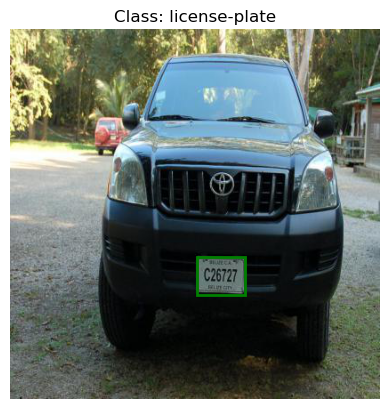

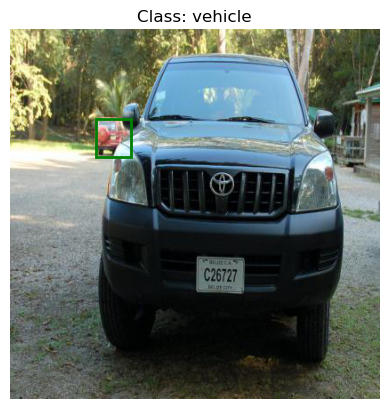

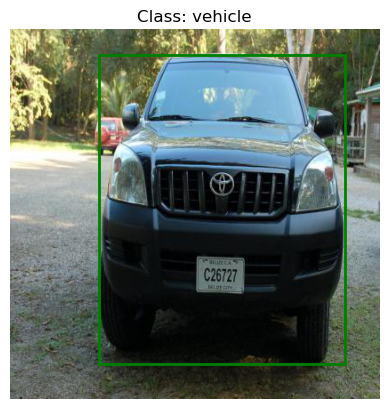

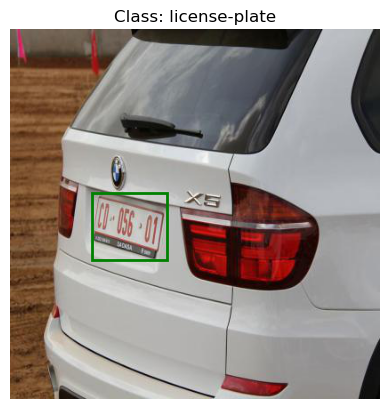

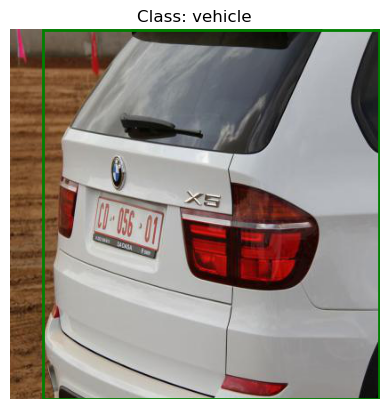

...

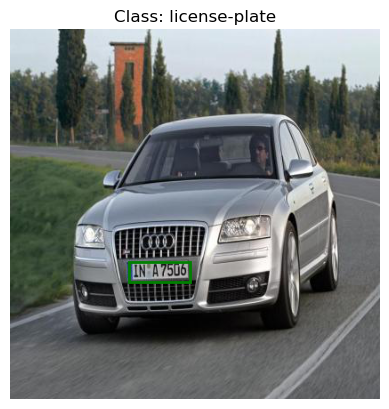

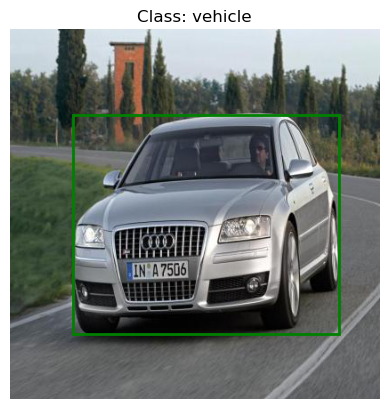

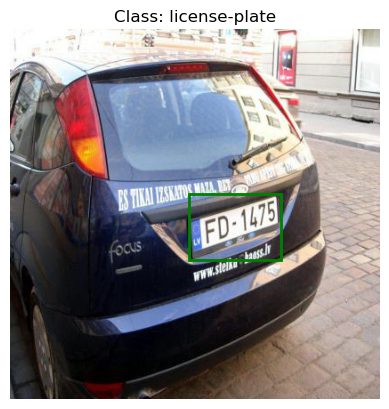

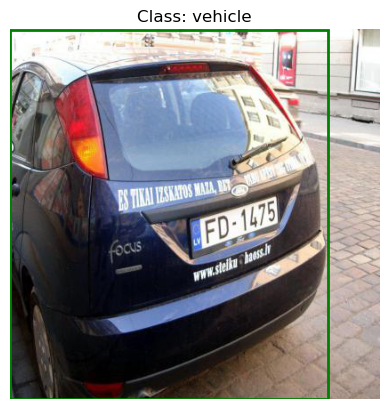

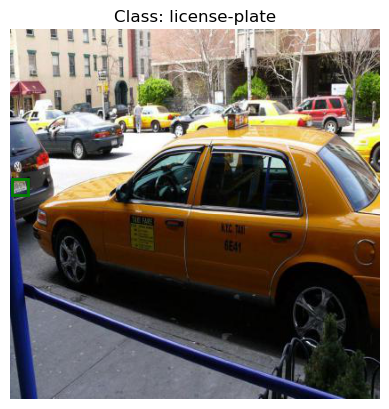

In [25]:
import os
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from PIL import Image

def visualize_data(image_path, label, xmin, ymin, xmax, ymax):
    # Charger l'image à l'aide de PIL
    img = Image.open(image_path)

    # Afficher l'image avec le rectangle et le label comme titre
    fig, ax = plt.subplots()
    ax.imshow(img)
    rect = patches.Rectangle((xmin, ymin), xmax - xmin, ymax - ymin, linewidth=2, edgecolor='g', facecolor='none')
    ax.add_patch(rect)
    plt.title(f"Class: {label}")
    plt.axis('off')  # Désactiver les axes
    plt.show()

def load_and_visualize_data(data_path, num_images=5):
    # Vérifier la présence du fichier _annotations.csv
    annotations_file = '_annotations.csv'
    if annotations_file not in os.listdir(data_path):
        print(f"Le fichier {annotations_file} n'est pas présent dans le répertoire {data_path}.")
        return

    # Charger les données à partir du fichier CSV
    data = pd.read_csv(os.path.join(data_path, annotations_file))

    # Ajouter le chemin du dossier aux noms de fichier dans le CSV
    data['filename'] = data['filename'].apply(lambda x: os.path.join(data_path, x))

    # Exemple : afficher les premières images avec rectangles autour des objets
    for i in range(min(num_images, len(data))):
        image_path, label = data.loc[i, ['filename', 'class']]
        xmin, ymin, xmax, ymax = data.loc[i, ['xmin', 'ymin', 'xmax', 'ymax']]

        visualize_data(image_path, label, xmin, ymin, xmax, ymax)

# Définir le chemin du dossier sur hp  pour chaque ensemble
test_path = 'C:/Users/hp/OneDrive/Bureau/project_dp/test'
train_path ='C:/Users/hp/OneDrive/Bureau/project_dp/train'
valid_path ='C:/Users/hp/OneDrive/Bureau/project_dp/valid'

# Charger et visualiser les données pour chaque ensemble
load_and_visualize_data(test_path)
load_and_visualize_data(train_path)
load_and_visualize_data(valid_path)

# 3- Exploratory Data Analysis(EDA)

In [7]:
df.shape

(1123, 8)

In [10]:
df.size

8984

In [11]:
df.tail()

,filename,width,height,class,xmin,ymin,xmax,ymax
1118,d830c3573e57bfc0_jpg.rf.e7fc2d97efb8e6132fbcf3...,416,416,vehicle,1,68,397,416
1119,fa897478280a2758_jpg.rf.d2bf1e1044188ef8857c52...,416,416,license-plate,215,250,289,297
1120,fa897478280a2758_jpg.rf.d2bf1e1044188ef8857c52...,416,416,vehicle,0,50,416,416
1121,fb55b73f241bf50a_jpg.rf.fbe131c0c520f889a41a27...,416,416,license-plate,149,244,274,294
1122,fb55b73f241bf50a_jpg.rf.fbe131c0c520f889a41a27...,416,416,vehicle,0,22,414,416


In [13]:
df.head()

,filename,width,height,class,xmin,ymin,xmax,ymax
0,ccc1a2d44a290368_jpg.rf.8e8d6f87f1d1327caf5f80...,416,416,license-plate,210,256,264,298
1,ccc1a2d44a290368_jpg.rf.8e8d6f87f1d1327caf5f80...,416,416,vehicle,96,100,136,143
2,ccc1a2d44a290368_jpg.rf.8e8d6f87f1d1327caf5f80...,416,416,vehicle,100,28,376,376
3,b6580dec5ada277d_jpg.rf.3ec17c0d68df1e6818d590...,416,416,license-plate,92,184,176,259
4,b6580dec5ada277d_jpg.rf.3ec17c0d68df1e6818d590...,416,416,vehicle,37,0,415,415


In [14]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1123 entries, 0 to 1122
Data columns (total 8 columns):
 #   Column    Non-Null Count  Dtype 
---  ------    --------------  ----- 
 0   filename  1123 non-null   object
 1   width     1123 non-null   int64 
 2   height    1123 non-null   int64 
 3   class     1123 non-null   object
 4   xmin      1123 non-null   int64 
 5   ymin      1123 non-null   int64 
 6   xmax      1123 non-null   int64 
 7   ymax      1123 non-null   int64 
dtypes: int64(6), object(2)
memory usage: 70.3+ KB


In [15]:
df.describe

<bound method NDFrame.describe of                                                filename  width  height  \
0     ccc1a2d44a290368_jpg.rf.8e8d6f87f1d1327caf5f80...    416     416   
1     ccc1a2d44a290368_jpg.rf.8e8d6f87f1d1327caf5f80...    416     416   
2     ccc1a2d44a290368_jpg.rf.8e8d6f87f1d1327caf5f80...    416     416   
3     b6580dec5ada277d_jpg.rf.3ec17c0d68df1e6818d590...    416     416   
4     b6580dec5ada277d_jpg.rf.3ec17c0d68df1e6818d590...    416     416   
...                                                 ...    ...     ...   
1118  d830c3573e57bfc0_jpg.rf.e7fc2d97efb8e6132fbcf3...    416     416   
1119  fa897478280a2758_jpg.rf.d2bf1e1044188ef8857c52...    416     416   
1120  fa897478280a2758_jpg.rf.d2bf1e1044188ef8857c52...    416     416   
1121  fb55b73f241bf50a_jpg.rf.fbe131c0c520f889a41a27...    416     416   
1122  fb55b73f241bf50a_jpg.rf.fbe131c0c520f889a41a27...    416     416   

              class  xmin  ymin  xmax  ymax  
0     license-plate   210   256

In [16]:
df.count()

filename    1123
width       1123
height      1123
class       1123
xmin        1123
ymin        1123
xmax        1123
ymax        1123
dtype: int64

In [17]:
df.max()

filename    ff85b09876d61631_jpg.rf.201dc4858f1861b27a121a...
width                                                     416
height                                                    416
class                                                 vehicle
xmin                                                      409
ymin                                                      381
xmax                                                      416
ymax                                                      416
dtype: object

In [19]:
df.min()

filename    003a5aaf6d17c917_jpg.rf.60e9d14047fc5cd445db13...
width                                                     416
height                                                    416
class                                           license-plate
xmin                                                        0
ymin                                                        0
xmax                                                        8
ymax                                                       14
dtype: object

In [21]:
df.columns

Index(['filename', 'width', 'height', 'class', 'xmin', 'ymin', 'xmax', 'ymax'], dtype='object')

In [22]:
df.isnull().sum()

filename    0
width       0
height      0
class       0
xmin        0
ymin        0
xmax        0
ymax        0
dtype: int64

In [24]:
duplicates= df.duplicated().sum()
duplicates

0

# 4- Visualization

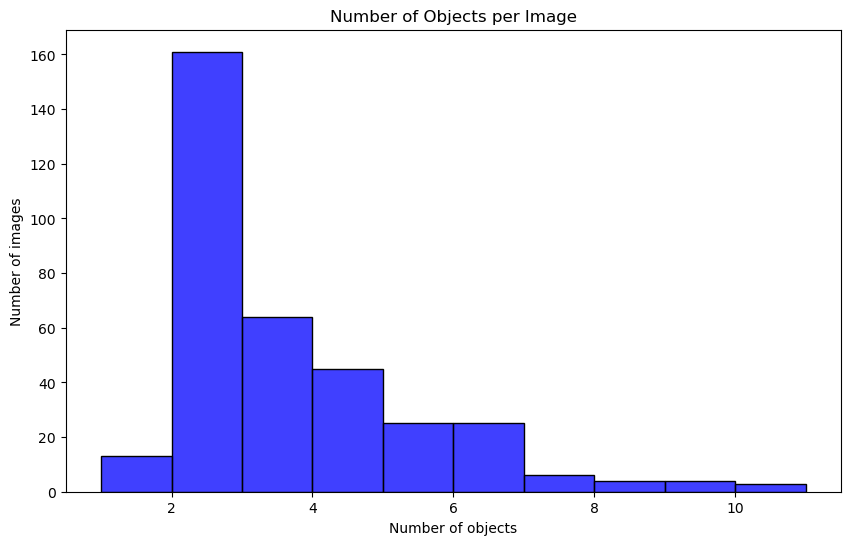

In [27]:
import matplotlib.pyplot as plt
import seaborn as sns

# Calculer le nombre d'objets par image
num_objects_per_image = df.groupby('filename').size().reset_index(name='num_objects')

# Tracer l'histogramme
plt.figure(figsize=(10, 6))
sns.histplot(num_objects_per_image['num_objects'], bins=range(1, max(num_objects_per_image['num_objects']) + 1), kde=False, color='blue')
plt.title('Number of Objects per Image')
plt.xlabel('Number of objects')
plt.ylabel('Number of images')
plt.show()

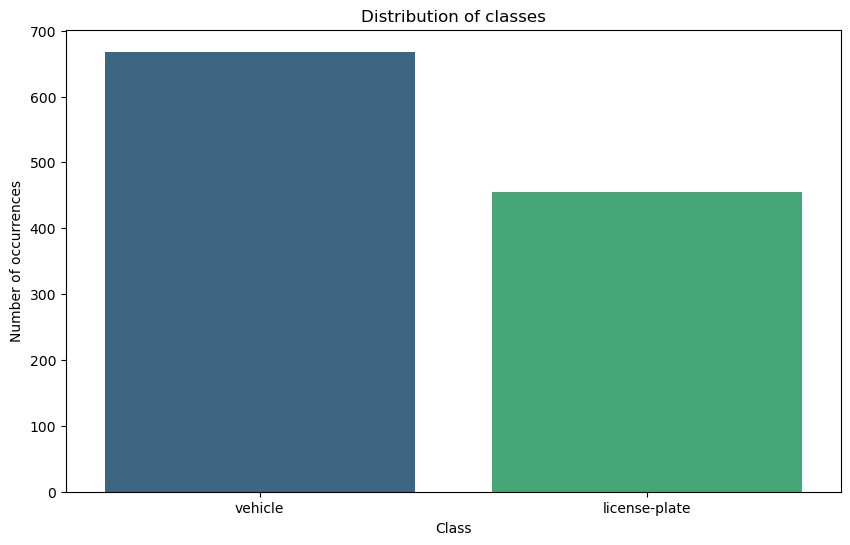

In [29]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Tracer un diagramme à barres pour la distribution des classes
plt.figure(figsize=(10, 6))
sns.countplot(x='class', data=df, order=df['class'].value_counts().index, palette='viridis')
plt.title('Distribution of classes')
plt.xlabel('Class')
plt.ylabel('Number of occurrences')
plt.show()

# 5- Data Preprocessing

## 5.1 Data Cleaning 

In [33]:
 df[df['class'] != 'vehicle']

,filename,width,height,class,xmin,ymin,xmax,ymax
0,ccc1a2d44a290368_jpg.rf.8e8d6f87f1d1327caf5f80...,416,416,license-plate,210,256,264,298
3,b6580dec5ada277d_jpg.rf.3ec17c0d68df1e6818d590...,416,416,license-plate,92,184,176,259
5,b1a50a3824887ee2_jpg.rf.68a4fd34fce20184287592...,416,416,license-plate,156,319,233,366
6,b1a50a3824887ee2_jpg.rf.68a4fd34fce20184287592...,416,416,license-plate,221,95,224,100
10,b91c3aaba25bf914_jpg.rf.1f03184f0c412a59b83c40...,416,416,license-plate,111,276,174,300
...,...,...,...,...,...,...,...,...
1112,d565d93637d4e76d_jpg.rf.f52836c9876bfd0e5089f8...,416,416,license-plate,209,301,273,330
1114,ff69d090c735eccb_jpg.rf.f9aa9152d27698703b9fbc...,416,416,license-plate,213,185,331,264
1117,d830c3573e57bfc0_jpg.rf.e7fc2d97efb8e6132fbcf3...,416,416,license-plate,167,316,219,342
1119,fa897478280a2758_jpg.rf.d2bf1e1044188ef8857c52...,416,416,license-plate,215,250,289,297


## 3.2 Enhancing quality of images

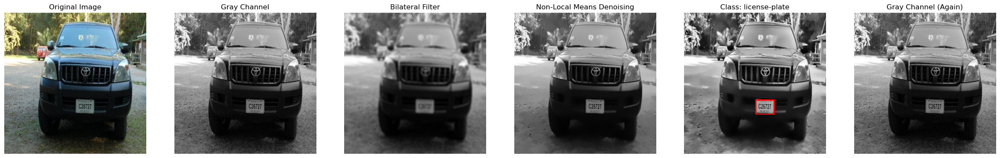

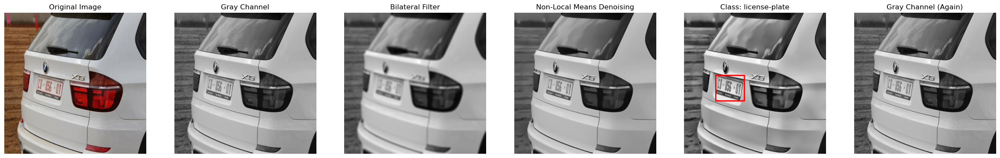

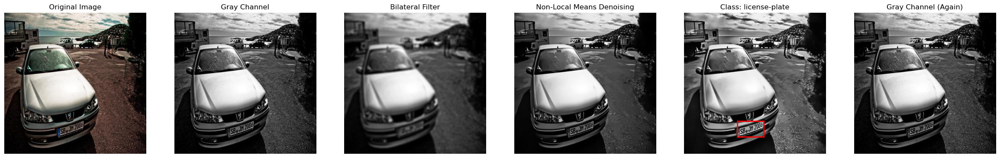

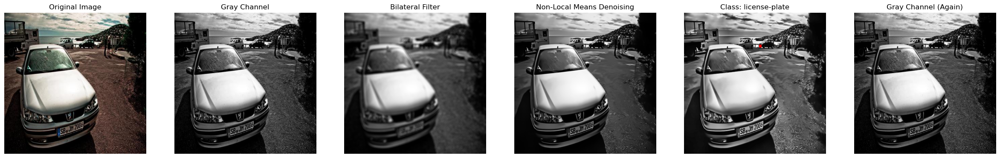

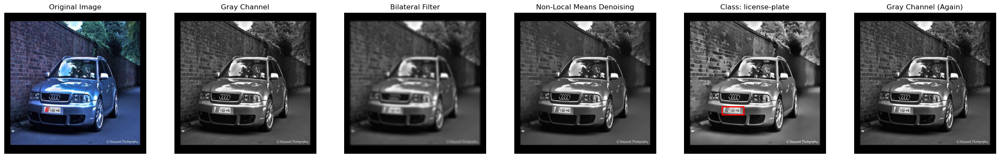

...

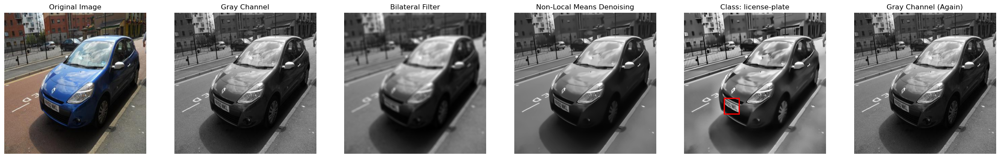

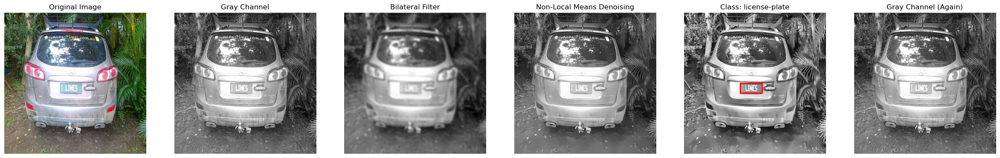

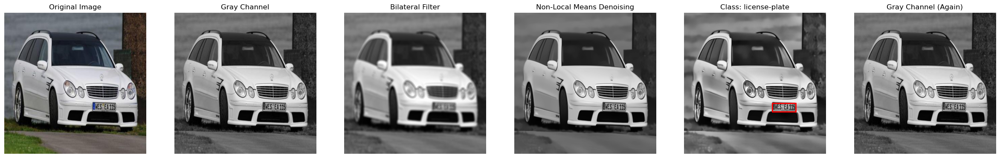

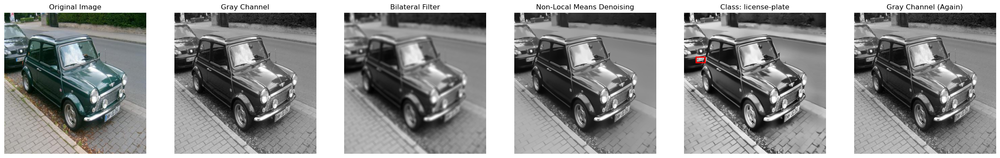

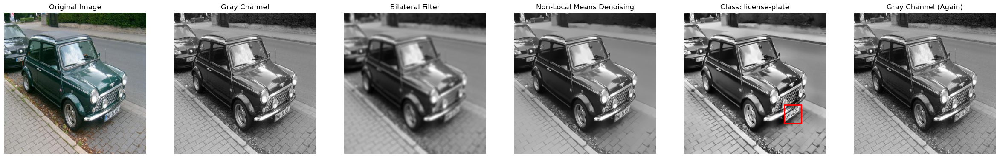

In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import os
import pandas as pd
from PIL import Image

def visualize_data(image_path, label, xmin, ymin, xmax, ymax):
    # Load the image using OpenCV
    img = cv2.imread(image_path)

    # Check if the image was loaded successfully
    if img is None:
        print(f"Error opening image {image_path}")
        return

    # Convert the image to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Apply bilateral filter for denoising
    denoised_bilateral = cv2.bilateralFilter(gray, 9, 500, 50000)  # Adjust parameters as needed

    # Apply non-local means denoising
    denoised_nlm = cv2.fastNlMeansDenoising(gray, None, h=10, searchWindowSize=21, templateWindowSize=7)  # Adjust parameters

    # Enhance contrast using CLAHE
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    enhanced = clahe.apply(denoised_nlm)

    # Display the image with a rectangle and label as title
    fig, axes = plt.subplots(1, 6, figsize=(30, 5))  # Increased to accommodate the additional channel

    # Original image
    axes[0].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    axes[0].set_title('Original Image')
    axes[0].axis('off')

    # Gray channel
    axes[1].imshow(gray, cmap='gray')
    axes[1].set_title('Gray Channel')
    axes[1].axis('off')

    # Image with bilateral filter
    axes[2].imshow(denoised_bilateral, cmap='gray')
    axes[2].set_title('Bilateral Filter')
    axes[2].axis('off')

    # Image with non-local means denoising
    axes[3].imshow(denoised_nlm, cmap='gray')
    axes[3].set_title('Non-Local Means Denoising')
    axes[3].axis('off')

    # Enhanced image with rectangle
    axes[4].imshow(enhanced, cmap='gray')
    rect = patches.Rectangle((xmin, ymin), xmax - xmin, ymax - ymin, linewidth=2, edgecolor='r', facecolor='none')
    axes[4].add_patch(rect)
    axes[4].set_title(f"Class: {label}")
    axes[4].axis('off')

    # Gray channel (again)
    axes[5].imshow(gray, cmap='gray')
    axes[5].set_title('Gray Channel (Again)')
    axes[5].axis('off')

    plt.show()

def load_and_visualize_data(data_path, num_images=10):
    # Check for the presence of the _annotations.csv file
    annotations_file = '_annotations.csv'
    if annotations_file not in os.listdir(data_path):
        print(f"The file {annotations_file} is not present in the directory {data_path}.")
        return

    # Load data from the CSV file
    data = pd.read_csv(os.path.join(data_path, annotations_file))
    data = data[data['class'] != 'vehicle']
    # Add the folder path to the file names in the CSV
    data['filename'] = data['filename'].apply(lambda x: os.path.join(data_path, x))

    # Example: display the first few images with rectangles and enhancements
    for i in range(min(num_images, len(data))):
        row = data.iloc[i]
        image_path, label = row['filename'], row['class']
        xmin, ymin, xmax, ymax = row['xmin'], row['ymin'], row['xmax'], row['ymax']

        visualize_data(image_path, label, xmin, ymin, xmax, ymax)

# Set the folder path for each dataset (same path for images and dataset)
dataset_path = 'C:/Users/hp/OneDrive/Bureau/project_dp'
test_path = os.path.join(dataset_path, 'test')
train_path = os.path.join(dataset_path, 'train')
valid_path = os.path.join(dataset_path, 'valid')

# Load and visualize the images for each dataset
load_and_visualize_data(test_path)
load_and_visualize_data(train_path)
load_and_visualize_data(valid_path)


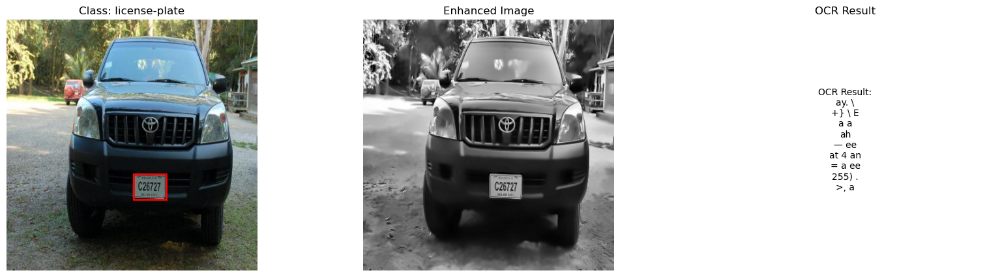

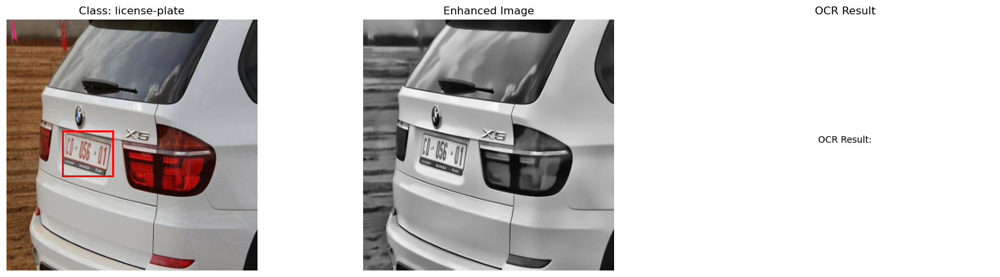

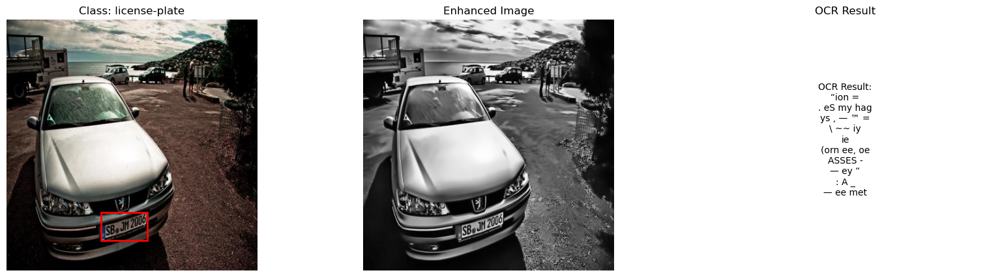

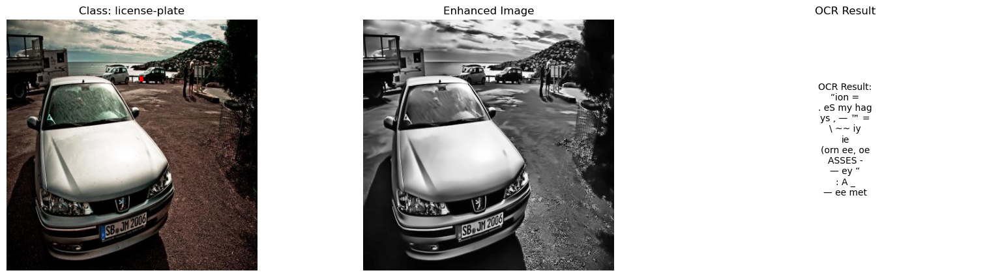

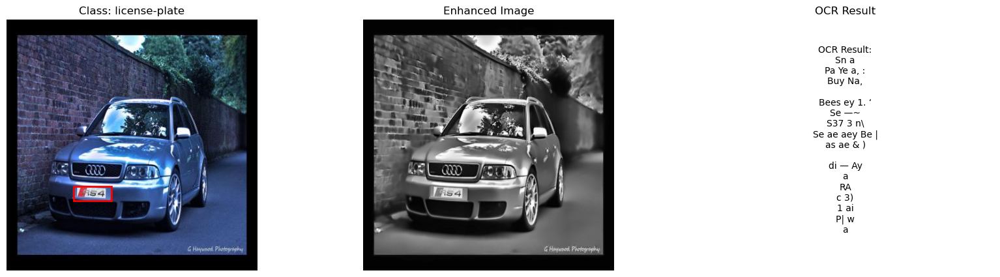

...

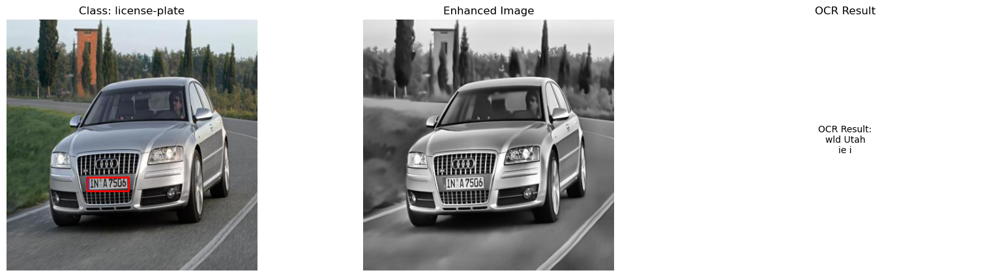

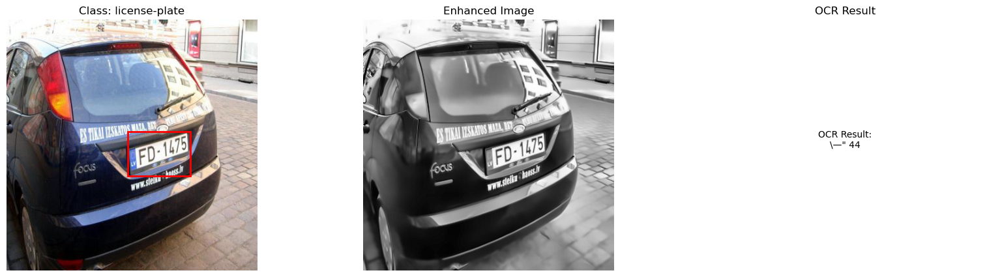

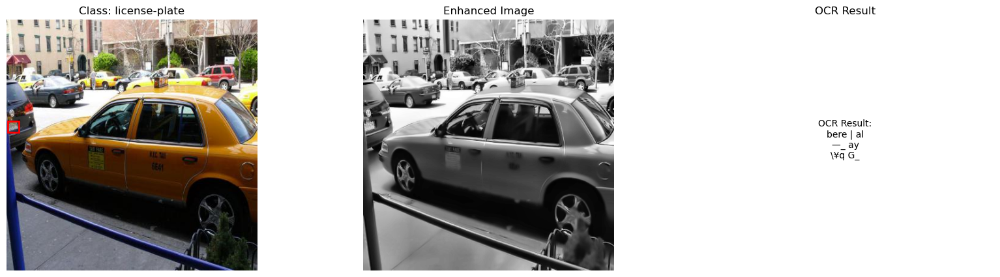

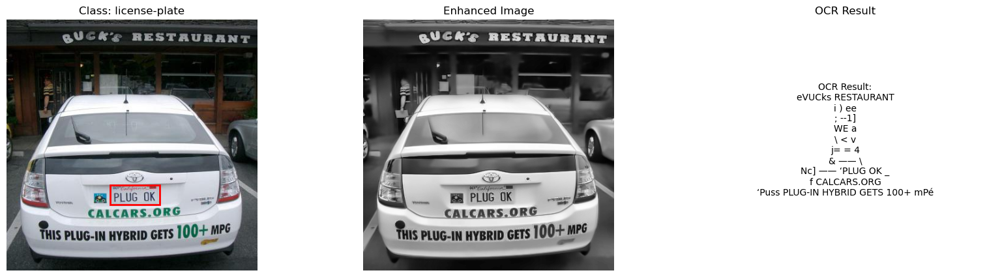

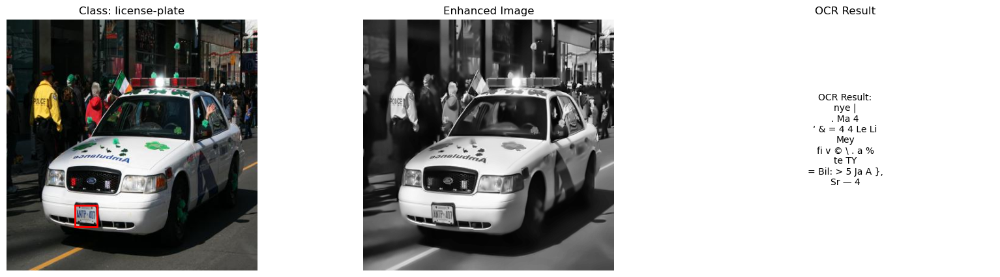

In [3]:
import cv2
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import os
import pandas as pd
from PIL import Image
import pytesseract

# Chemin vers le fichier exécutable de Tesseract
pytesseract.pytesseract.tesseract_cmd = 'C:\\Program Files\\Tesseract-OCR\\tesseract.exe'

def enhance_image(img):
    # Convert the image to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Apply bilateral filter for denoising
    denoised_bilateral = cv2.bilateralFilter(gray, 9, 50000, 50000)  # Adjust parameters as needed

    # Apply non-local means denoising
    denoised_nlm = cv2.fastNlMeansDenoising(gray, None, h=10, searchWindowSize=21, templateWindowSize=7)  # Adjust parameters

    # Enhance contrast using CLAHE
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    enhanced = clahe.apply(denoised_nlm)

    return enhanced

def visualize_data_with_ocr(image_path, label, xmin, ymin, xmax, ymax):
    # Load the image using OpenCV
    img = cv2.imread(image_path)

    # Check if the image was loaded successfully
    if img is None:
        print(f"Error opening image {image_path}")
        return

    # Enhance the image
    enhanced = enhance_image(img)

    # Display the image with a rectangle, label, and OCR result
    fig, axes = plt.subplots(1, 3, figsize=(20, 5))

    # Original image
    axes[0].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    axes[0].add_patch(patches.Rectangle((xmin, ymin), xmax - xmin, ymax - ymin, linewidth=2, edgecolor='r', facecolor='none'))
    axes[0].set_title(f"Class: {label}")
    axes[0].axis('off')

    # Enhanced image
    axes[1].imshow(enhanced, cmap='gray')
    axes[1].set_title('Enhanced Image')
    axes[1].axis('off')

    # OCR on the enhanced image
    text = pytesseract.image_to_string(enhanced, config='--psm 6')
    axes[2].text(0.5, 0.5, f'OCR Result:\n{text}', horizontalalignment='center', verticalalignment='center', fontsize=10)
    axes[2].set_title("OCR Result")
    axes[2].axis('off')

    plt.show()

def load_and_visualize_data_with_ocr(data_path, num_images=5):
    # Check for the presence of the _annotations.csv file
    annotations_file = '_annotations.csv'
    if annotations_file not in os.listdir(data_path):
        print(f"The file {annotations_file} is not present in the directory {data_path}.")
        return

  
    data = pd.read_csv(os.path.join(data_path, annotations_file))
    data = data[data['class'] != 'vehicle']
    # Add the folder path to the file names in the CSV
    data['filename'] = data['filename'].apply(lambda x: os.path.join(data_path, x))

   
    for i in range(min(num_images, len(data))):
        row = data.iloc[i]
        image_path, label = row['filename'], row['class']
        xmin, ymin, xmax, ymax = row['xmin'], row['ymin'], row['xmax'], row['ymax']

        visualize_data_with_ocr(image_path, label, xmin, ymin, xmax, ymax)


dataset_path = 'C:/Users/hp/OneDrive/Bureau/project_dp'
test_path = os.path.join(dataset_path, 'test')
train_path = os.path.join(dataset_path, 'train')
valid_path = os.path.join(dataset_path, 'valid')


load_and_visualize_data_with_ocr(test_path)
load_and_visualize_data_with_ocr(train_path)
load_and_visualize_data_with_ocr(valid_path)
